# Airbnb project

- Katrine Bay s183910, Gustav Larsen s180820, Rasmus Aagaard s164419 and Mathilde Block s204201.

## Introduction

In this project we will be working with data from Airbnb. The data is from the city of Copenhagen, Denmark, and contains information about the listings, the hosts and the reviews. The csv file 'listings_CPH' is provided as project material, while the additional csv files are from [InsideAirbnb](http://insideairbnb.com/get-the-data/) and contain quarterly data for the last 12 months. 







## Data analysis and visualization

In [1]:
# loading packages etc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
pd.set_option('display.max_rows', 500)


In [2]:
# read in the data
listings = pd.read_csv('data/listings_CPH.csv') # the provided project data
listings_ = pd.read_csv('data/listings.csv') 
reviews = pd.read_csv('data/reviews.csv')
neighbourhoods = pd.read_csv('data/neighbourhoods.csv')

# gz zipped files
calendar_gz = pd.read_csv('data/calendar.csv.gz', compression='gzip',
                   error_bad_lines=False)
listings_gz = pd.read_csv('data/listings.csv.gz',compression='gzip',
                   error_bad_lines=False)                   
reviews_gz = pd.read_csv('data/reviews.csv.gz',compression='gzip',
                   error_bad_lines=False)  


In [8]:
# joining dataframes 
df_reviews = pd.merge(reviews, reviews_gz, on = ['listing_id','date'])

cols_to_use = listings_.columns.difference(listings_gz.columns)
df_listings = pd.merge(listings_gz, listings_[cols_to_use], left_index=True, right_index=True, how='outer')
df_listings.price = df_listings.price.str.replace('$', '')
df_listings.price = df_listings.price.str.replace(',', '')
df_listings.price = pd.to_numeric(df_listings['price'])


## Map of Copenhagen with Airbnb listings

To get an overview of the data, we will start by plotting the Airbnb listings on a map of Copenhagen. The map is created using the [Folium](https://python-visualization.github.io/folium/) library. The map is interactive, and the listings can be clicked on to show the neighborhood of the listing together with the price of the listing. To investigate how the pricing differs based on location in copehagen, the listings have been colored acording to 5 price quantiles rangein from <span style="color:blue">blue</span> (the cheapest and 0-20% of the price range), <span style="color:green">green</span> (20-40%), <span style="color:yellow">yellow</span> (40-60%), <span style="color:orange">orange</span> (60-80%), and <span style="color:red">red</span> (the top 20% of the price range). 

The map is created by using the function 'plot_map' which takes the dataframe as input. The function uses the latitude and longitude of the listings to plot the listings on the map. The function also takes the column name of the price as input, and uses this to color the listings. The function also takes the name of the column containing the neighborhood as input, and uses this to show the neighborhood when the listing is clicked on.

In [230]:
import folium
traffic_map = folium.Map(location=[55.687654, 12.544755], zoom_start=13)
df_listings['price_index_quartile'] = pd.qcut(df_listings['price'], 5, labels=False)
colordict = {0: 'blue', 1: 'green', 2: 'yellow', 3: 'orange', 4: 'red'} 


for lat, lon, price_q, neighbourhood_cleansed, price in zip(df_listings['latitude'], df_listings['longitude'],df_listings['price_index_quartile'], df_listings['neighbourhood_cleansed'], df_listings['price']):
    folium.CircleMarker(
        [lat, lon],
         popup = ('Neighbourhood: ' + str(neighbourhood_cleansed).capitalize() + '<br>'
                  'Price: ' + str(price)
                 ),
        color='b',
        radius=5,
        key_on = price_q,
        fill_color=colordict[price_q],
        fill=True,
        fill_opacity=0.4
        ).add_to(traffic_map)
traffic_map

## Interpretation of map

The map shows that the listings are spread out all over Copenhagen. Generally, the listings are more concentrated in the center of Copenhagen, and the price of the listings increases the closer to the center of Copenhagen the listing is. The map also shows that there are some areas in Copenhagen where there are no listings. This could be due to the fact that some areas of Copenhagen are under construction, or that there simply are no Airbnb hosts in these areas.

The trend of pricing is also visible in the map. The listings in the center of Copenhagen are more expensive than the listings in the outskirts of Copenhagen. 

To Investigate this further, a boxplot of the pricing in each neighbordhood is presented below. 

<!-- This is also visible in the histogram of the prices, which shows that the prices are more concentrated in the lower price range in the outskirts of Copenhagen, while the prices are more concentrated in the higher price range in the center of Copenhagen. -->


<!-- The most listings are in the center of Copenhagen, and the fewest listings on the outer rim of Copenhagen city.  -->



In [30]:
# investigate which neighbordhood has the larges density of listings

# create a new dataframe with the number of listings per neighbourhood
df_neighbourhoods = pd.DataFrame(df_listings['neighbourhood_cleansed'].value_counts())
df_neighbourhoods.reset_index(inplace=True)
df_neighbourhoods.columns = ['neighbourhood_cleansed', 'listings_count']

# add mean price for each neighbourhood
df_neighbourhoods = pd.merge(df_neighbourhoods, df_listings.groupby('neighbourhood_cleansed')['price'].mean(), on='neighbourhood_cleansed')

Text(0.5, 0, 'Neighbourhood')

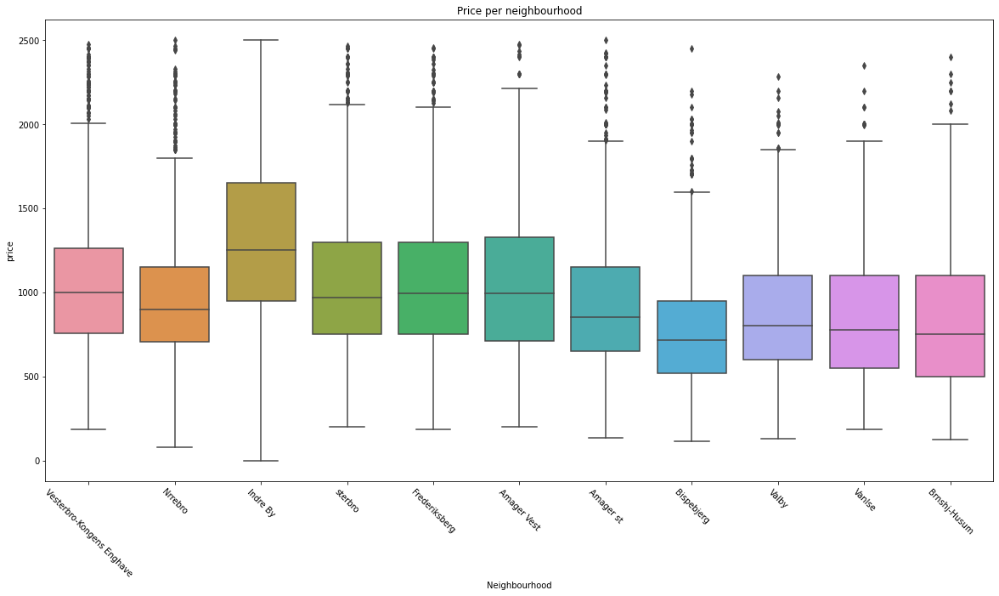

In [31]:
# boxplot of price per neighbourhood and number of listings per neighbourhood

# define the order of the distributions in the boxplot
frequency_order = df_neighbourhoods.sort_values('listings_count', ascending=False)['neighbourhood_cleansed'].values
 
fig, ax = plt.subplots(figsize=(20,10))
sns.boxplot(x='neighbourhood_cleansed', y='price', data=df_listings[df_listings.price < 2500], ax=ax,order = frequency_order)
ax.set_xticklabels(ax.get_xticklabels(), rotation=-45)
ax.set_title('Price per neighbourhood')
ax.set_xlabel('Neighbourhood')

# fig, ax = plt.subplots(figsize=(20,10))
# sns.barplot(x='neighbourhood_cleansed', y='listings_count', data=df_neighbourhoods, ax=ax)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

# plt.show()

## Interpretation of boxplot

The boxplot supports the claim that the price of the listings in the center of Copenhagen is higher than the price of the listings in the outskirts of Copenhagen. The boxplot also shows that the price of the listings in the center of Copenhagen is more spread out than the price of the listings in the outskirts of Copenhagen. 

The distributions of the box plot is orderes to present the neighborhood with the most listings (Vesterbro-Kongens Enghave) to the neighborhood with the fewest listings (Brønshøj-Husum). This is done to make it easier to compare the neighborhoods.

# next visualization

Idea: is this just a product of the fact that there are a higher concentrarion of the expensive room types in the center of copenhagen? Is this a simpsons paradox? 



<AxesSubplot:xlabel='room_type', ylabel='price'>

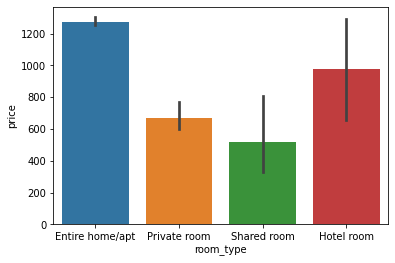

In [32]:
sns.barplot(x='room_type', y='price', data=df_listings)

In [35]:
# what room_type has the neighborhoods the most of?
df_listings.groupby(['neighbourhood_cleansed','room_type'])['room_type'].count()

# add mean price of each room type to the dataframe
df_room_type = pd.DataFrame(df_listings.groupby(['neighbourhood_cleansed','room_type'])['price'].mean())
df_room_type.reset_index(inplace=True)
df_room_type.columns = ['neighbourhood_cleansed', 'room_type', 'price']
df_room_type

,neighbourhood_cleansed,room_type,price
0,Amager Vest,Entire home/apt,1408.319288
1,Amager Vest,Private room,1002.624242
2,Amager Vest,Shared room,1051.500000
3,Amager st,Entire home/apt,1115.591116
4,Amager st,Hotel room,1296.000000
5,Amager st,Private room,612.090909
6,Amager st,Shared room,1567.500000
7,Bispebjerg,Entire home/apt,983.137457
8,Bispebjerg,Private room,485.217391
9,Bispebjerg,Shared room,198.000000


<AxesSubplot:xlabel='room_type', ylabel='price'>

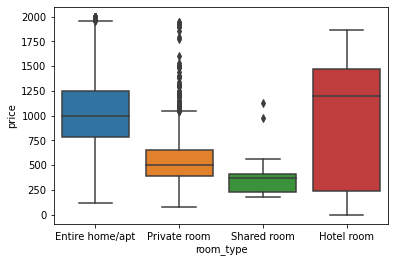

In [ ]:
# excluding the outliers 
sns.boxplot(x='room_type', y='price', data=listings[listings['price'] < 2000])

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

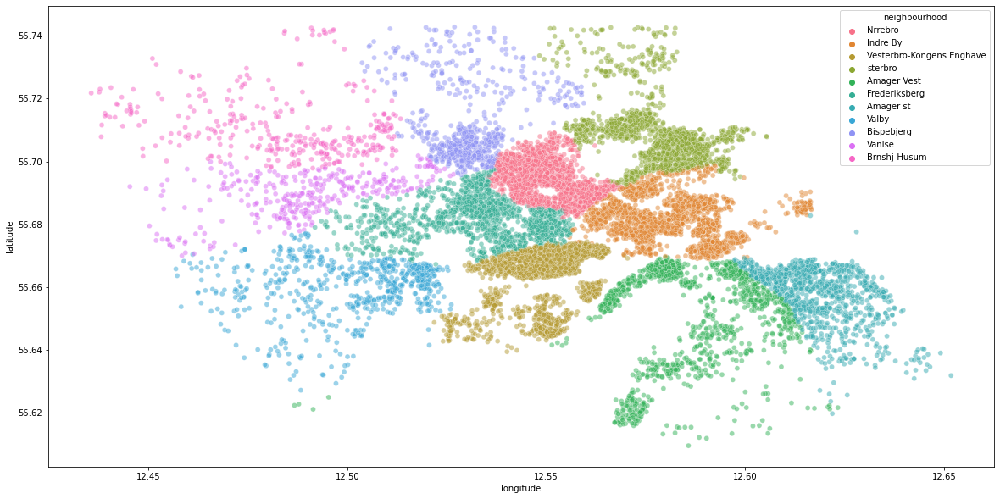

In [ ]:
# mapping out Copenhagen
# size figure
plt.figure(figsize=(20, 10))
sns.scatterplot(x='longitude', y='latitude', data=listings, hue='neighbourhood', alpha=0.5)

Text(0.5, 1.0, 'Price per neighborhood')

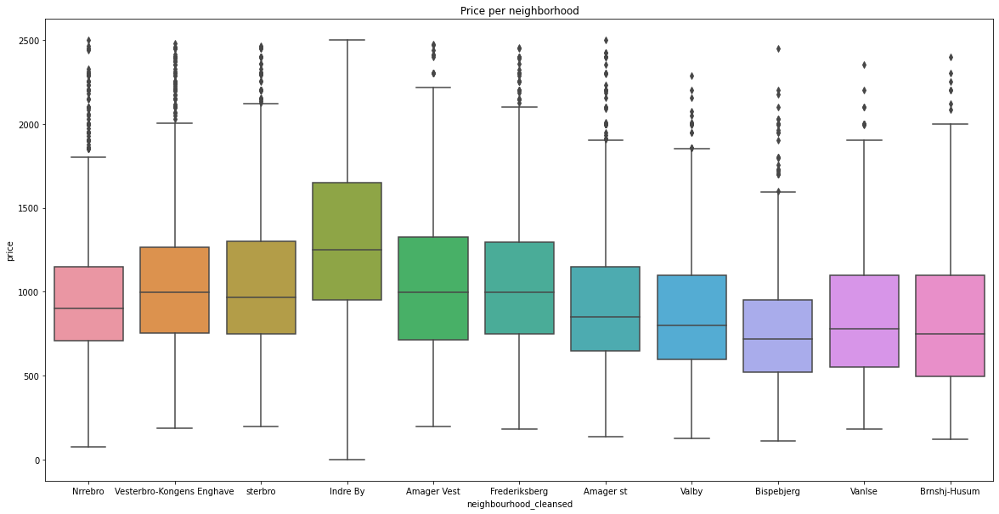

In [223]:
# correlation between price and neighborhood 
# size figure
plt.figure(figsize=(20, 10))
sns.boxplot(x='neighbourhood_cleansed', y='price', data=df_listings[df_listings['price'] < 2500])
plt.title('Price per neighborhood')

In [87]:
plt.figure(figsize=(20, 10))
sns.boxplot(x='neighbourhood_group', y='review_scores_rating', data=df_listings[df_listings['review_scores_rating'] > 4.5])


ValueError: min() arg is an empty sequence

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

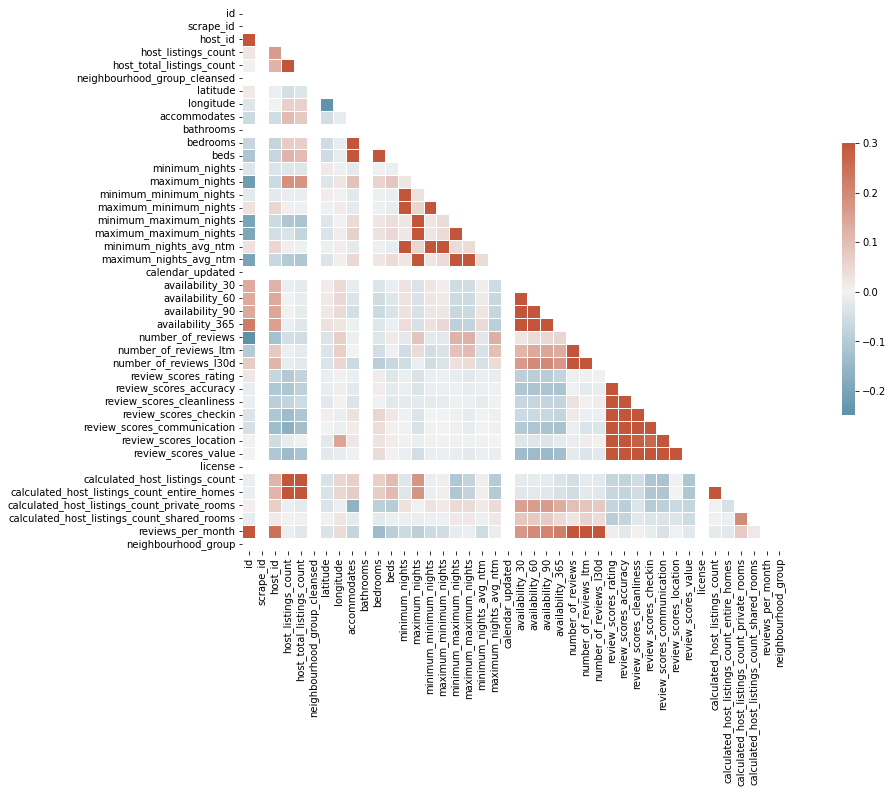

In [90]:
# Compute the correlation matrix
corr = df_listings.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(20, 10))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})